<!-- Notebook title -->
# Title

# 1. Notebook Description

### 1.1 Task Description
<!-- 
- A brief description of the problem you're solving with machine learning.
- Define the objective (e.g., classification, regression, clustering, etc.).
-->

TODO

### 1.2 Useful Resources
<!--
- Links to relevant papers, articles, or documentation.
- Description of the datasets (if external).
-->

### 1.2.1 Data

#### 1.2.1.1 Common

* [Datasets Kaggle](https://www.kaggle.com/datasets)  
  &nbsp;&nbsp;&nbsp;&nbsp;A vast repository of datasets across various domains provided by Kaggle, a platform for data science competitions.
  
* [Toy datasets from Sklearn](https://scikit-learn.org/stable/datasets/toy_dataset.html)  
  &nbsp;&nbsp;&nbsp;&nbsp;A collection of small datasets that come with the Scikit-learn library, useful for quick prototyping and testing algorithms.
  
* [UCI Machine Learning Repository](https://archive.ics.uci.edu/ml/index.php)  
  &nbsp;&nbsp;&nbsp;&nbsp;A widely-used repository for machine learning datasets, with a variety of real-world datasets available for research and experimentation.
  
* [Google Dataset Search](https://datasetsearch.research.google.com/)  
  &nbsp;&nbsp;&nbsp;&nbsp;A tool from Google that helps to find datasets stored across the web, with a focus on publicly available data.
  
* [AWS Public Datasets](https://registry.opendata.aws/)  
  &nbsp;&nbsp;&nbsp;&nbsp;A registry of publicly available datasets that can be analyzed on the cloud using Amazon Web Services (AWS).
  
* [Microsoft Azure Open Datasets](https://azure.microsoft.com/en-us/services/open-datasets/)  
  &nbsp;&nbsp;&nbsp;&nbsp;A collection of curated datasets from various domains, made available by Microsoft Azure for use in machine learning and analytics.
  
* [Awesome Public Datasets](https://github.com/awesomedata/awesome-public-datasets)  
  &nbsp;&nbsp;&nbsp;&nbsp;A GitHub repository that lists a wide variety of datasets across different domains, curated by the community.
  
* [Data.gov](https://www.data.gov/)  
  &nbsp;&nbsp;&nbsp;&nbsp;A portal to the US government's open data, offering access to a wide range of datasets from various federal agencies.
  
* [Google BigQuery Public Datasets](https://cloud.google.com/bigquery/public-data)  
  &nbsp;&nbsp;&nbsp;&nbsp;Public datasets hosted by Google BigQuery, allowing for quick and powerful querying of large datasets in the cloud.
  
* [Papers with Code](https://paperswithcode.com/datasets)  
  &nbsp;&nbsp;&nbsp;&nbsp;A platform that links research papers with the corresponding code and datasets, helping researchers reproduce results and explore new data.
  
* [Zenodo](https://zenodo.org/)  
  &nbsp;&nbsp;&nbsp;&nbsp;An open-access repository that allows researchers to share datasets, software, and other research outputs, often linked to academic publications.
  
* [The World Bank Open Data](https://data.worldbank.org/)  
  &nbsp;&nbsp;&nbsp;&nbsp;A comprehensive source of global development data, with datasets covering various economic and social indicators.
  
* [OpenML](https://www.openml.org/)  
  &nbsp;&nbsp;&nbsp;&nbsp;An online platform for sharing datasets, machine learning experiments, and results, fostering collaboration in the ML community.
  
* [Stanford Large Network Dataset Collection (SNAP)](https://snap.stanford.edu/data/)  
  &nbsp;&nbsp;&nbsp;&nbsp;A collection of large-scale network datasets from Stanford University, useful for network analysis and graph-based machine learning.
  
* [KDnuggets Datasets](https://www.kdnuggets.com/datasets/index.html)  
  &nbsp;&nbsp;&nbsp;&nbsp;A curated list of datasets for data mining and data science, compiled by the KDnuggets community.


#### 1.2.1.2 Project

### 1.2.2 Learning

* [K-Nearest Neighbors on Kaggle](https://www.kaggle.com/code/mmdatainfo/k-nearest-neighbors)

* [Complete Guide to K-Nearest-Neighbors](https://kevinzakka.github.io/2016/07/13/k-nearest-neighbor)

### 1.2.3 Documentation

---

# 2. Setup

## 2.1 Imports
<!--
- Import necessary libraries (e.g., `numpy`, `pandas`, `matplotlib`, `scikit-learn`, etc.).
-->

In [61]:
from ikt450.src.common_imports import *
from ikt450.src.config import get_paths
from ikt450.src.common_func import load_dataset, save_dataframe, ensure_dir_exists

import torch
import torchvision
import torchvision.transforms as transforms

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device


device(type='cuda')

## 2.2 Global Variables
<!--
- Define global constants, paths, and configuration settings used throughout the notebook.
-->

### 2.2.1 Paths

In [62]:
paths = get_paths()

### 2.2.2 Seed

In [63]:
RANDOM_SEED = 7

### 2.2.3 Split ratio

In [64]:
SPLITRATIO = 0.8

## 2.3 Function Definitions
<!--
- Define helper functions that will be used multiple times in the notebook.
- Consider organizing these into separate sections (e.g., data processing functions, model evaluation functions).
-->

# 4. Data Processing

In [65]:
import datetime
import torch
from torchvision import transforms
from torchvision.transforms.functional import to_pil_image, to_tensor
from PIL import ImageDraw, ImageFont
import torchvision.datasets as datasets

# Mean and std for normalization
mean = [0.485, 0.456, 0.406]  # ImageNet mean
std = [0.229, 0.224, 0.225]   # ImageNet std

# Custom transformation to add a date stamp
from PIL import ImageDraw, ImageFont
import datetime
import torch
from torchvision.transforms.functional import to_pil_image, to_tensor

class AddDateStampTransform:
    def __init__(self):
        self.date = datetime.datetime.now().strftime("%B %d, %Y")

    def __call__(self, image_tensor):
        # Convert Tensor to PIL Image for adding text\


        image = to_pil_image(torch.clamp(image_tensor, 0, 1))  # Clamp values to [0, 1]
        image_org = image.copy()
        draw = ImageDraw.Draw(image)
        font = ImageFont.load_default()

        # Coordinates for the text position
        x, y = 10 , 10
        x, y = torch.randint(5, image.width - 50, (1,)).item(), torch.randint(5, image.height - 20, (1,)).item()

        # Draw the outline (black)
        outline_color = (0, 0, 0)
        for offset in [(-1, -1), (-1, 1), (1, -1), (1, 1)]:  # Four corners around the text
            draw.text((x + offset[0], y + offset[1]), self.date, font=font, fill=outline_color)

        # Draw the main text (white)
        draw.text((x, y), self.date, font=font, fill=(255, 255, 255))

        image = to_tensor(image)
        image_org = to_tensor(image_org)

        diff = torch.abs(image - image_org)
        diff = torch.where(diff > 0.1, torch.tensor(1), diff)

        # where diff is 1, keep the original image, otherwise keep the stamped image
        image = torch.where(diff == 1, image, image_tensor)



        # Convert back to Tensor
        return image, image_tensor


# Define the common transformation sequence without adding the date stamp
train_transform = transforms.Compose([
    transforms.RandomResizedCrop(224),        # Randomly crop the image to 224x224
    #transforms.RandomHorizontalFlip(),        # Randomly flip the image horizontally
   # transforms.RandomRotation(15),            # Randomly rotate the image by 15 degrees
    transforms.ColorJitter(                   # Randomly change brightness, contrast, saturation, and hue
        brightness=0.1, contrast=0.1, saturation=0.1, hue=0.1
    ),
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std),
])

test_transform = transforms.Compose([
    transforms.RandomResizedCrop(224),        # Randomly crop the image to 224x224
  #  transforms.RandomHorizontalFlip(),        # Randomly flip the image horizontally
  #  transforms.RandomRotation(15),            # Randomly rotate the image by 15 degrees
   # transforms.ColorJitter(                   # Randomly change brightness, contrast, saturation, and hue
    #    brightness=0.1, contrast=0.1, saturation=0.1, hue=0.1
    #),
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std),
])

# Custom dataset to apply transformations separately for the stamped and non-stamped versions
class StampedImageDataset(torch.utils.data.Dataset):
    def __init__(self, root, base_transform, stamp_transform=None):
        self.dataset = datasets.ImageFolder(root=root)
        self.base_transform = base_transform
        self.stamp_transform = stamp_transform if stamp_transform else lambda x: x

    def __getitem__(self, index):
        # Load image and apply base transformation
        img, label = self.dataset[index]
        transformed_img = self.base_transform(img)
        
        # Create stamped image by applying the stamp transformation
        stamped_img,transformed_img = self.stamp_transform(transformed_img.clone())
        
        return stamped_img, transformed_img, label

    def __len__(self):
        return len(self.dataset)

# Initialize dataset with stamping transformation
train_dataset = StampedImageDataset(
    root=f"{paths['PATH_COMMON_DATASETS']}/food11/training",
    base_transform=train_transform,
    stamp_transform=AddDateStampTransform()
)

val_dataset = StampedImageDataset(
    root=f"{paths['PATH_COMMON_DATASETS']}/food11/validation",
    base_transform=test_transform,
    stamp_transform=AddDateStampTransform()
)

test_dataset = StampedImageDataset(
    root=f"{paths['PATH_COMMON_DATASETS']}/food11/evaluation",
    base_transform=test_transform,
    stamp_transform=AddDateStampTransform()
)

# You can load it into a DataLoader as usual
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=32, shuffle=False)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=8, shuffle=False)


In [66]:
# display the original image and the reconstructed image
#  and display the difference between the original and the reconstructed image

def display_images(original, reconstructed):
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
    for ax in axes:
        ax.axis("off")
    # denormalize images
    original = original * torch.tensor(std).view(3, 1, 1) + torch.tensor(mean).view(3, 1, 1)
    reconstructed = reconstructed * torch.tensor(std).view(3, 1, 1) + torch.tensor(mean).view(3, 1, 1)

    
    axes[0].imshow(original.permute(1, 2, 0))
    axes[0].set_title("Original")
    
    axes[1].imshow(reconstructed.permute(1, 2, 0))
    axes[1].set_title("Reconstructed")
    
    diff = torch.abs(original - reconstructed)
    axes[2].imshow(diff.permute(1, 2, 0))
    axes[2].set_title("Difference")
    
    plt.tight_layout()
    plt.show()






In [67]:

# Load and display image from dataloader


---

# 5. Model Development

In [68]:
# create an GAN

import torch.nn as nn
import torch.nn.functional as F



import torch.nn as nn
import torch.nn.functional as F
import torch

class Autoencoder(nn.Module):
    def __init__(self):
        super(Autoencoder, self).__init__()
        
        # Encoder
        self.enc_conv1 = nn.Conv2d(3, 64, 3, padding=1)
        self.enc_bn1 = nn.BatchNorm2d(64)
        self.enc_conv2 = nn.Conv2d(64, 128, 3, padding=1)
        self.enc_bn2 = nn.BatchNorm2d(128)
        self.enc_conv3 = nn.Conv2d(128, 256, 3, padding=1)
        self.enc_bn3 = nn.BatchNorm2d(256)
        self.pool = nn.MaxPool2d(2, 2)  # Reduces size by a factor of 2

        # 1x1 Convolutions for skip connections to match channels
        self.conv_match_x3 = nn.Conv2d(256, 128, 1)
        self.conv_match_x2 = nn.Conv2d(128, 64, 1)
        self.conv_match_x1 = nn.Conv2d(64, 3, 1)  # Match x1 to 3 channels

        # Decoder
        self.dec_t_conv1 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.dec_bn1 = nn.BatchNorm2d(128)
        self.dec_t_conv2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.dec_bn2 = nn.BatchNorm2d(64)
        self.dec_t_conv3 = nn.ConvTranspose2d(64, 3, 2, stride=2)  # Final output

    def forward(self, x):
        # Encoder forward pass
        x1 = F.relu(self.enc_bn1(self.enc_conv1(x)))  # Size: 224x224 -> 224x224
        x2 = self.pool(x1)  # Size: 224x224 -> 112x112
        x2 = F.relu(self.enc_bn2(self.enc_conv2(x2)))  # Size: 112x112 -> 112x112
        x3 = self.pool(x2)  # Size: 112x112 -> 56x56
        x3 = F.relu(self.enc_bn3(self.enc_conv3(x3)))  # Size: 56x56 -> 56x56
        x4 = self.pool(x3)  # Size: 56x56 -> 28x28

        # Decoder forward pass with skip connections
        x4 = F.relu(self.dec_bn1(self.dec_t_conv1(x4)))  # Size: 28x28 -> 56x56
        x3_matched = self.conv_match_x3(x3)  # Match channels of x3 to x4
        x4 = x4 + x3_matched  # Skip connection

        x4 = F.relu(self.dec_bn2(self.dec_t_conv2(x4)))  # Size: 56x56 -> 112x112
        x2_matched = self.conv_match_x2(x2)  # Match channels of x2 to x4
        x4 = x4 + x2_matched  # Skip connection

        x1_matched = self.conv_match_x1(x1)  # Match channels of x1 to the final layer's output
        x4 = self.dec_t_conv3(x4) + x1_matched # Size: 112x112 -> 224x224, final skip connection

        return x4





class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, 3, padding=1)
        self.conv2 = nn.Conv2d(64, 128, 3, padding=1)
        self.conv3 = nn.Conv2d(128, 256, 3, padding=1)
        self.pool = nn.MaxPool2d(2, 2)
        
        # Add a 1x1 convolution to reduce the channels to 512
        self.conv4 = nn.Conv2d(256, 512, 1)
        
        # Final convolutional layer that reduces the output to one channel (binary classification)
        self.conv5 = nn.Conv2d(512, 1, 1)

    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = self.pool(x)
        x = F.relu(self.conv2(x))
        x = self.pool(x)
        x = F.relu(self.conv3(x))
        x = self.pool(x)
        x = F.relu(self.conv4(x))
        
        # Apply global average pooling to reduce to 1x1
        x = F.adaptive_avg_pool2d(x, (1, 1))
        x = self.conv5(x)  # Output will be of shape [batch_size, 1, 1, 1]
        return x.squeeze(-1).squeeze(-1)  # Reduce dimensions to [batch_size, 1]




In [69]:
# generator
encoder_model = Autoencoder()

encoder_model.to(device)


discriminator_model = Discriminator()
discriminator_model.to(device)

# Define the loss function and optimizer


optimizer_generator = torch.optim.Adam(encoder_model.parameters(), lr=0.0001)

optimizer_discriminator = torch.optim.Adam(discriminator_model.parameters(), lr=0.00002)

adversarial_loss = nn.BCEWithLogitsLoss()





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.10366592..1.8742044].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [2.4437904e-06..1.8428319].


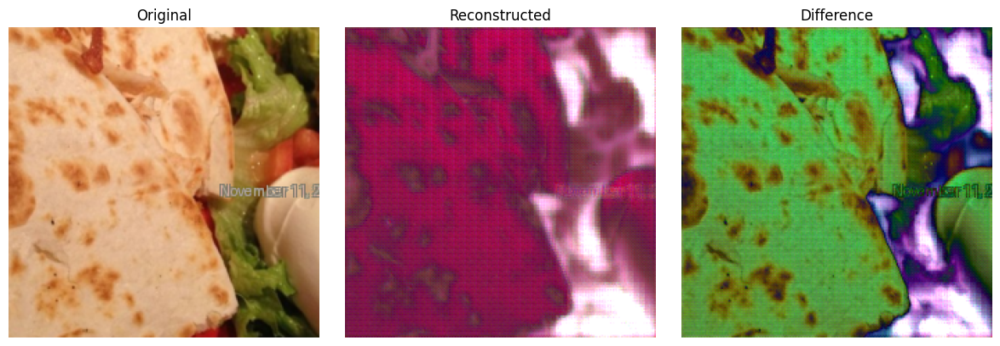

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.09970215..1.7005577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [4.082918e-06..1.5868323].


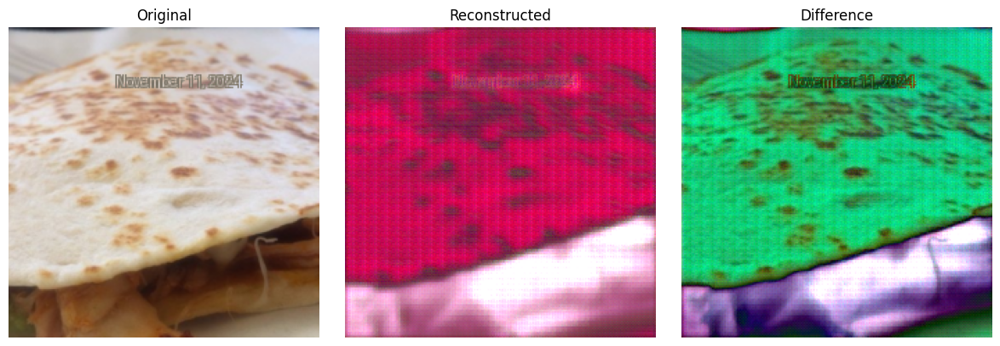

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.13100573..1.9503931].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [1.1622906e-06..1.9307852].


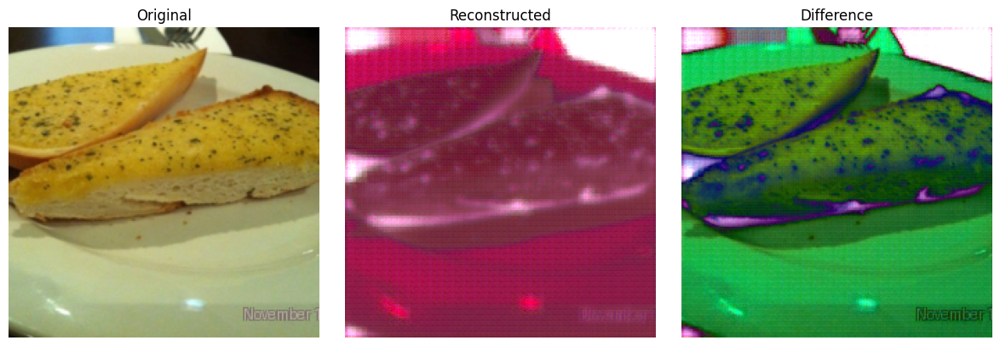

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.11696103..1.8717558].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [2.6226044e-06..1.8207755].


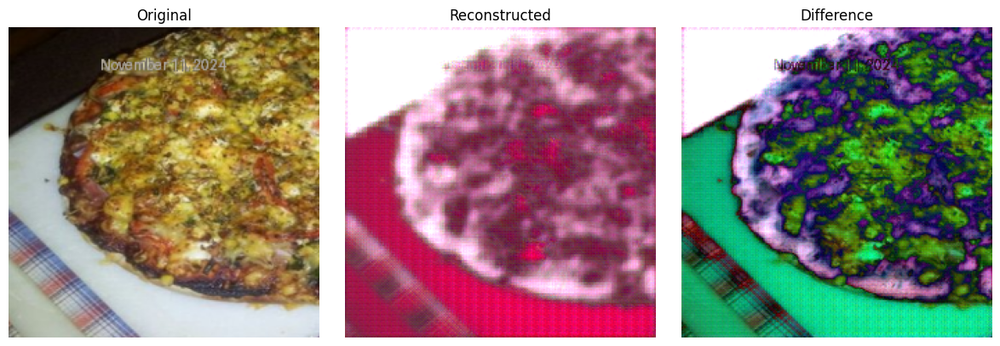

Epoch [1/200], Loss D: 0.6839, Loss G: 0.7146
Epoch [1/200], Loss D: 211.7856, Loss G: 228.7024


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.13771966..1.4527636].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [6.467104e-06..1.4267529].


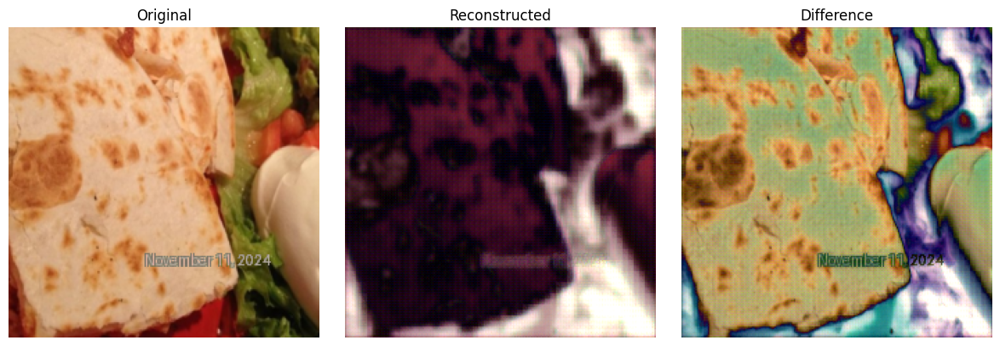

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07755378..1.2995747].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [3.552437e-05..1.1819277].


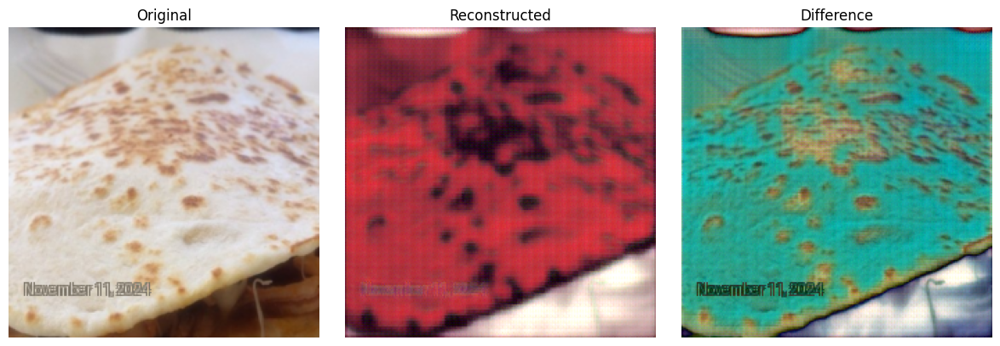

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.22041902..1.5267439].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [4.7683716e-06..1.5228224].


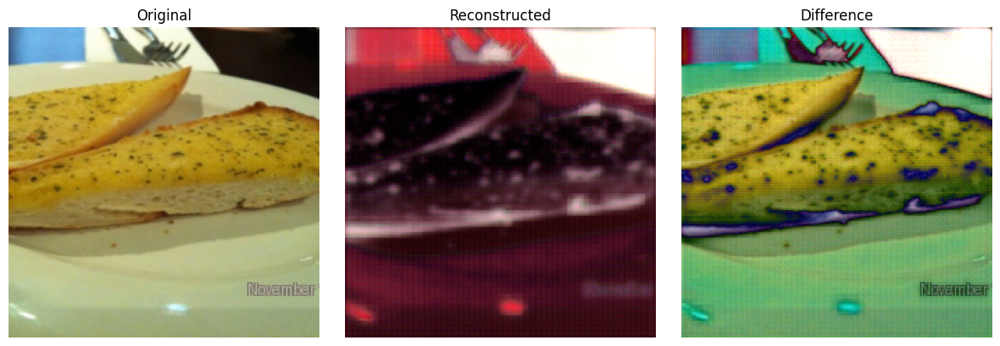

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16995117..1.5464051].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [5.7816505e-06..1.5464051].


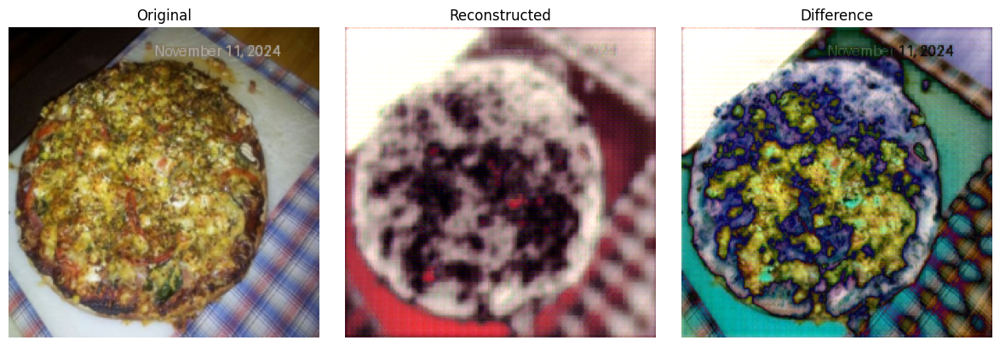

Epoch [2/200], Loss D: 0.6568, Loss G: 0.7519
Epoch [2/200], Loss D: 213.6495, Loss G: 222.2394


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.20896055..1.5238258].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [7.3611736e-06..1.4846101].


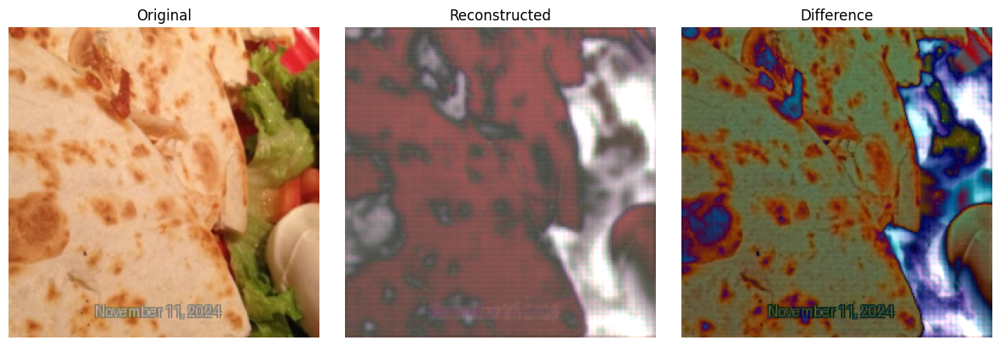

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.18593204..1.389296].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [4.6610832e-05..1.327092].


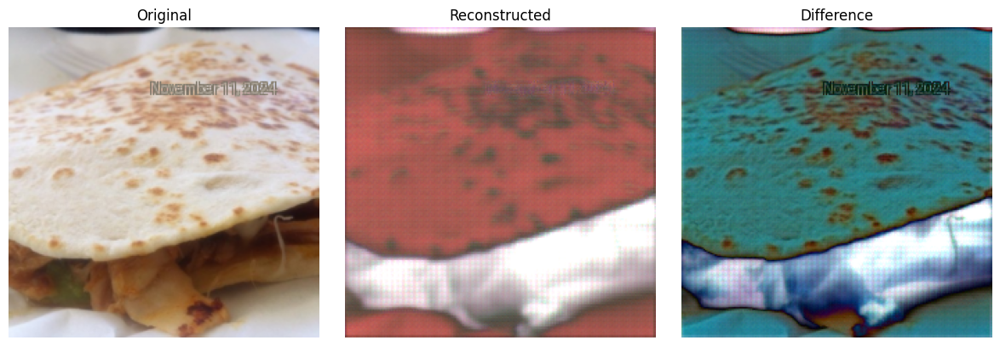

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.14428008..1.5957458].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [3.3676624e-06..1.5918243].


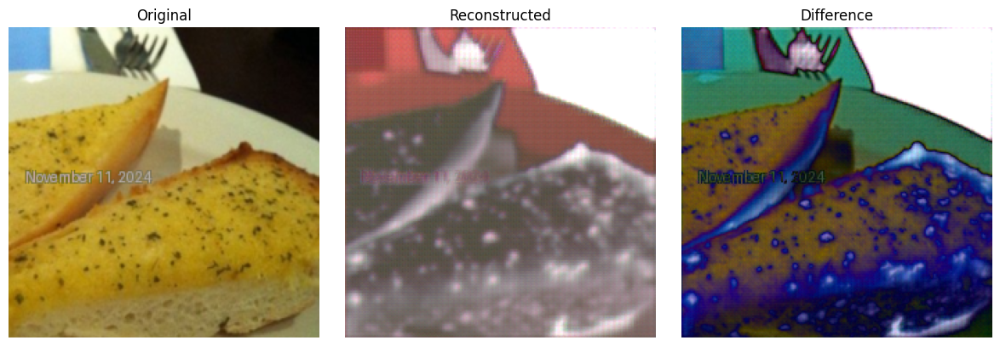

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.19256948..1.4935954].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [1.013279e-06..1.4565836].


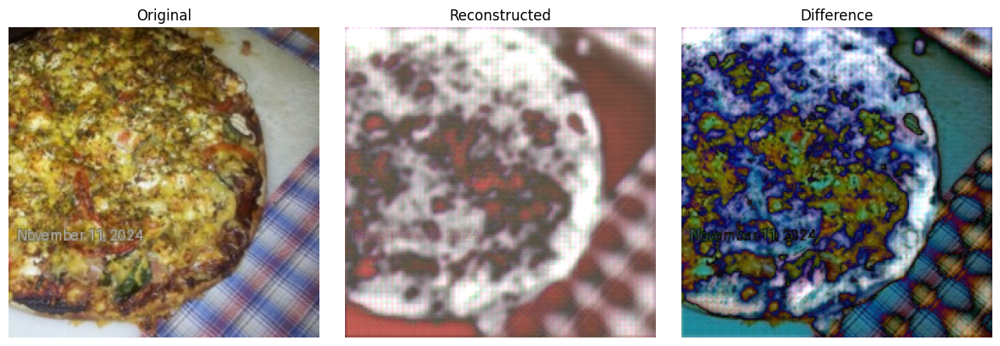

Epoch [3/200], Loss D: 0.7353, Loss G: 0.6606
Epoch [3/200], Loss D: 212.0910, Loss G: 225.4261


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.04687643..1.7494779].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [1.6331673e-05..1.7259485].


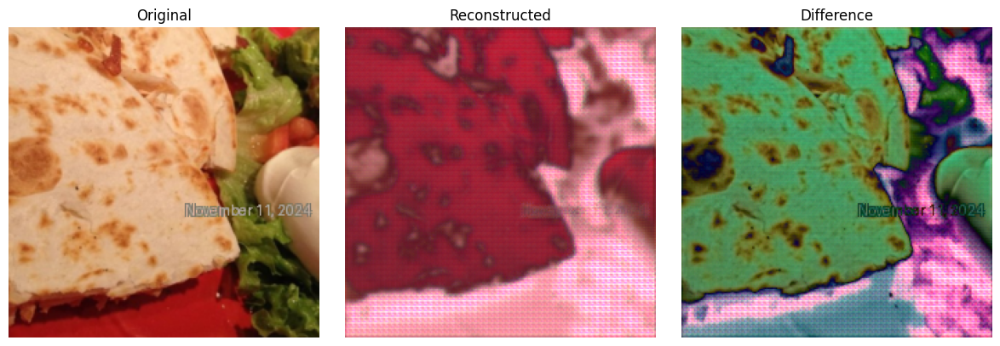

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.06119612..1.6344843].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [2.026558e-06..1.5233147].


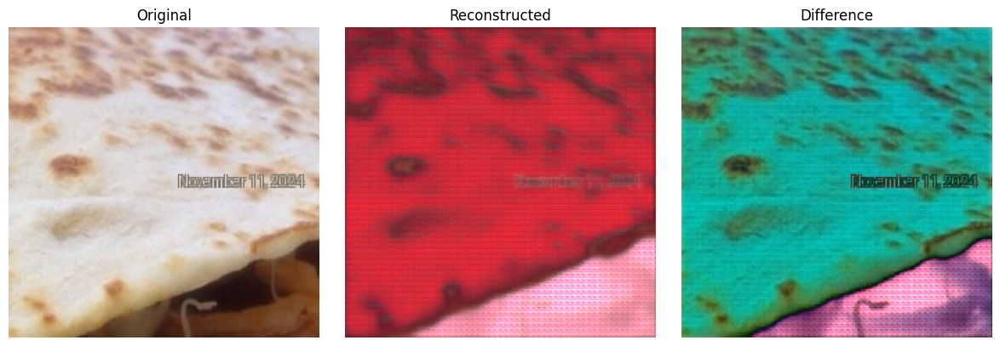

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.07795781..1.34999].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [8.6426735e-07..1.1107743].


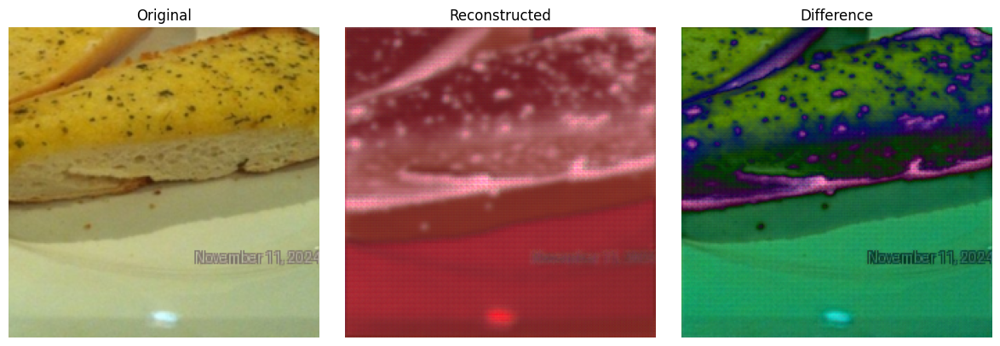

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.056414753..1.7514714].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [7.033348e-06..1.7135216].


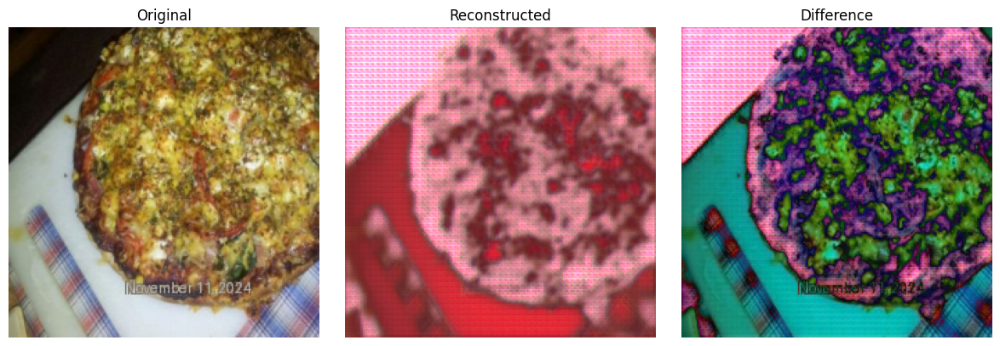

Epoch [4/200], Loss D: 0.7207, Loss G: 0.6729
Epoch [4/200], Loss D: 213.0637, Loss G: 232.8654


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06418055..1.1543492].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [1.30832195e-05..1.1277333].


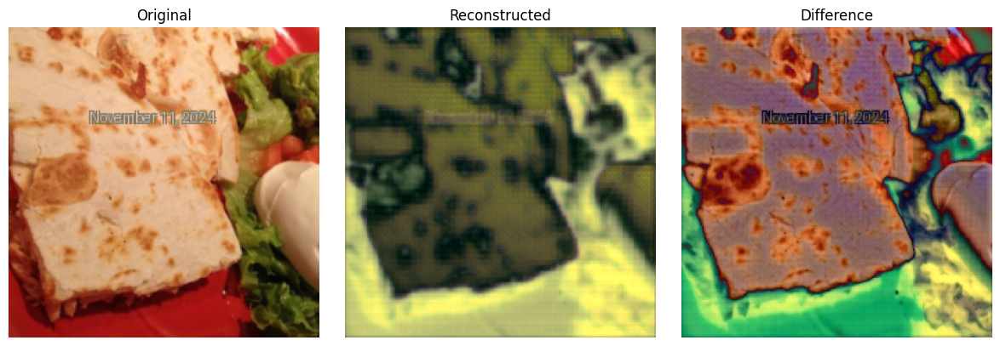

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.01591742..1.0544183].


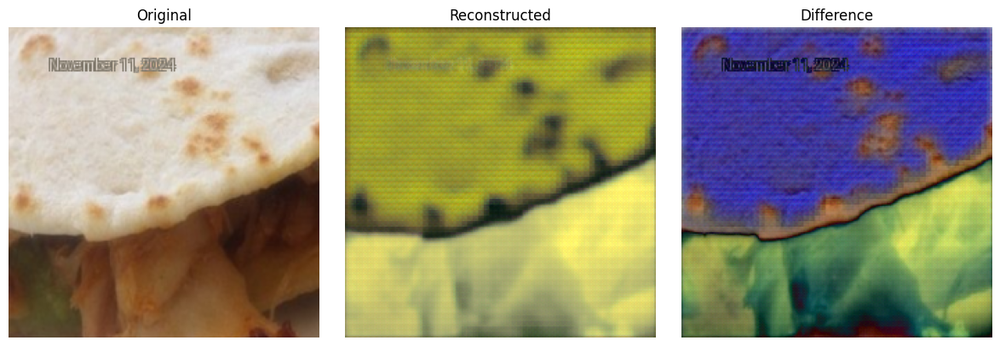

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.037142217..0.9252554].


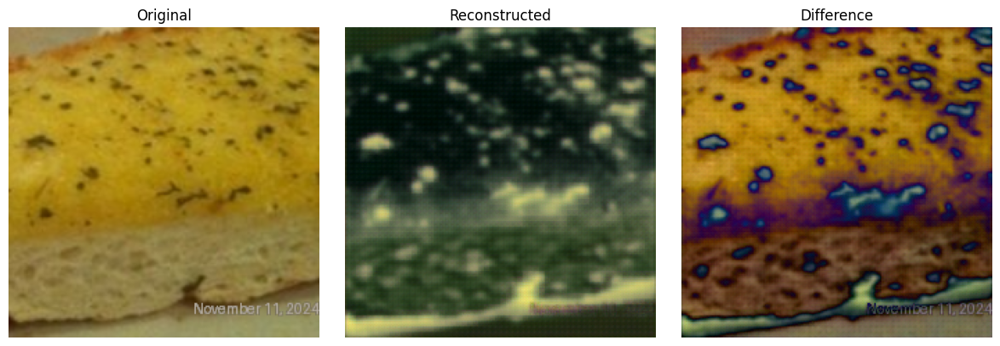

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.040215373..1.1182042].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [5.9604645e-08..1.051461].


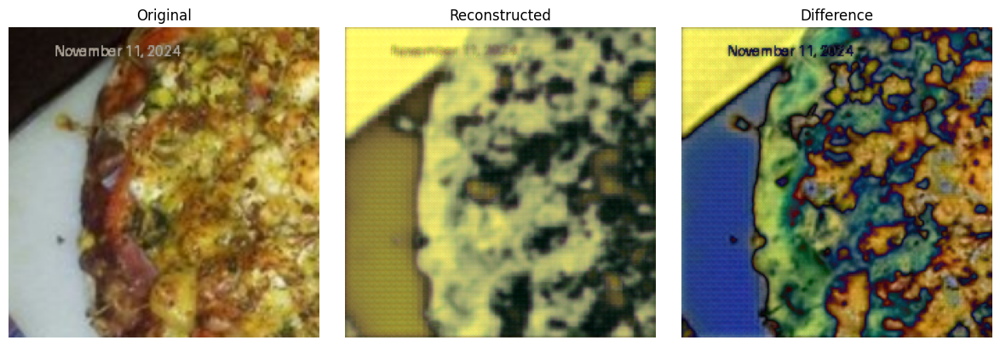

Epoch [5/200], Loss D: 0.6850, Loss G: 0.7065
Epoch [5/200], Loss D: 212.8647, Loss G: 213.6630


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.05710748..1.1131289].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [8.6426735e-07..1.0374997].


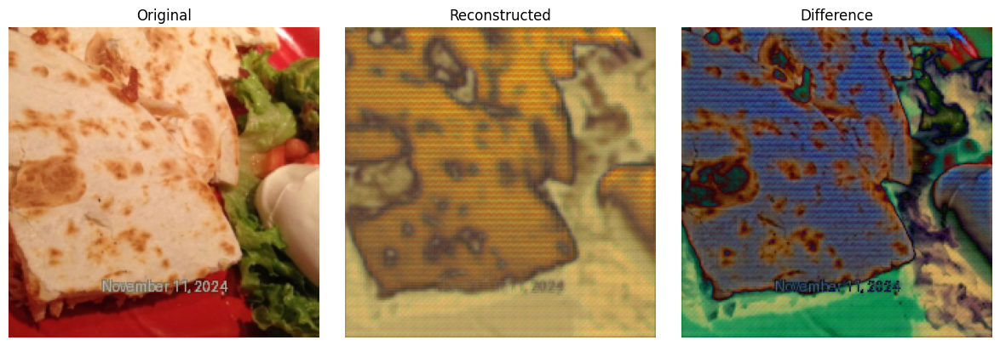

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.056381285..1.1980145].


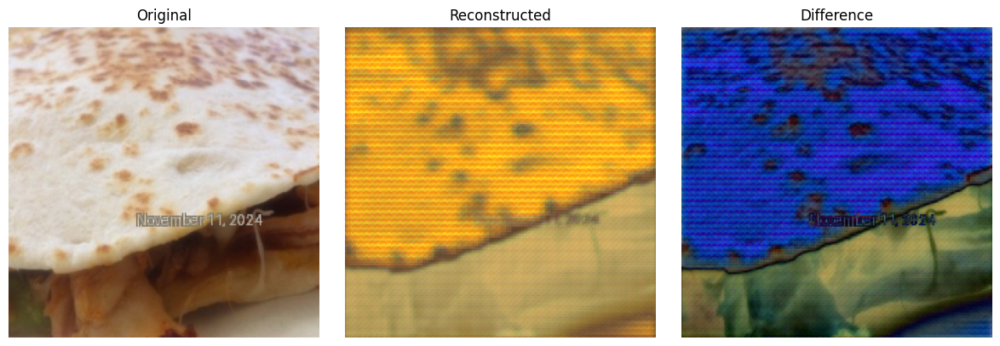

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.1447579..1.366483].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [4.7683716e-07..1.0872543].


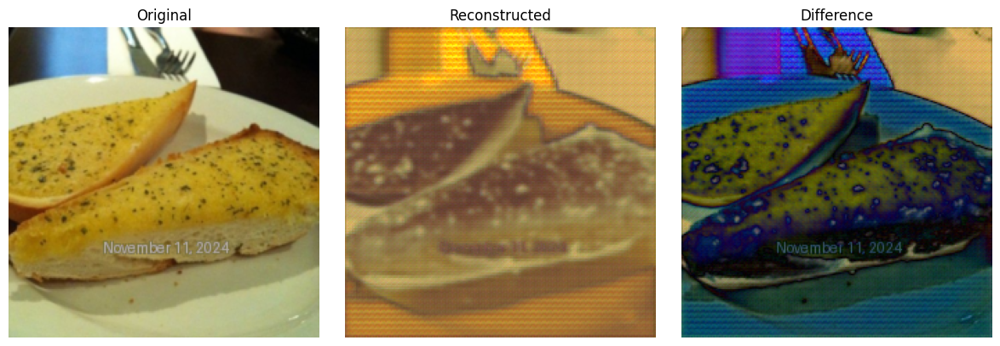

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.031018317..1.1999357].


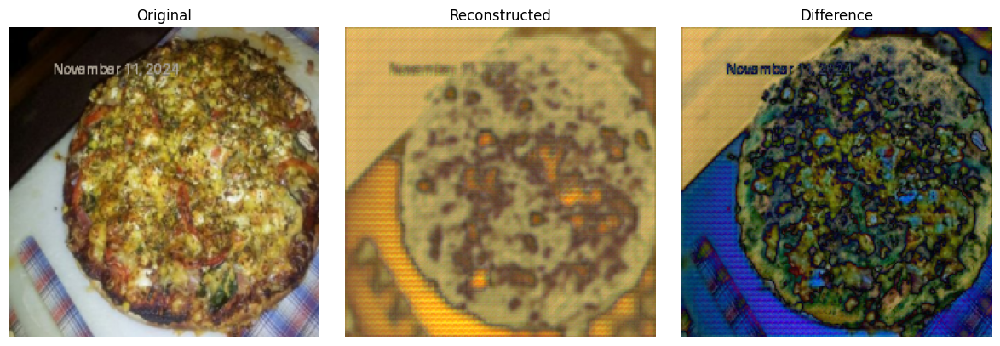

Epoch [6/200], Loss D: 0.7743, Loss G: 0.6201
Epoch [6/200], Loss D: 214.7836, Loss G: 216.9812


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16593215..1.1486193].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [6.943941e-06..1.1094036].


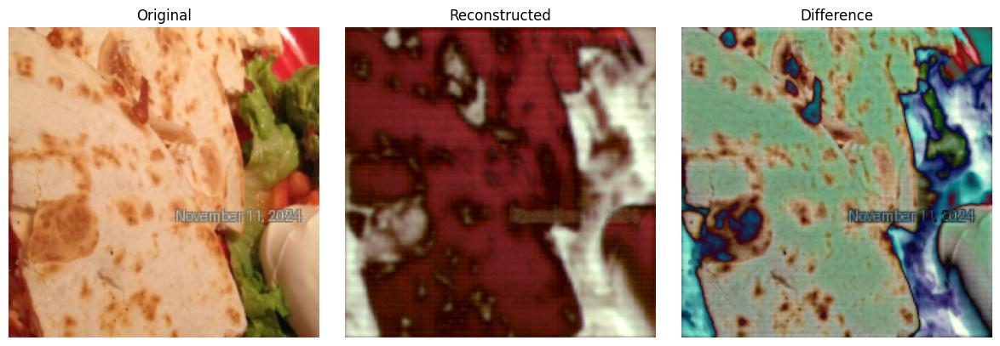

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.084320694..0.83663005].


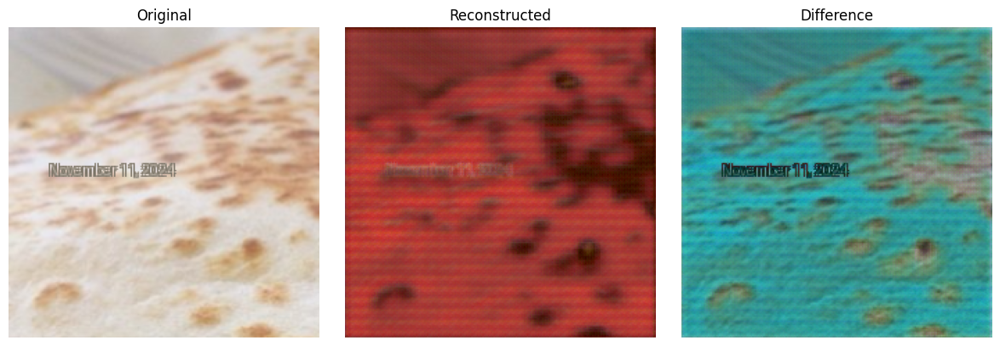

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.17847022..1.2060689].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [1.1920929e-06..1.1943042].


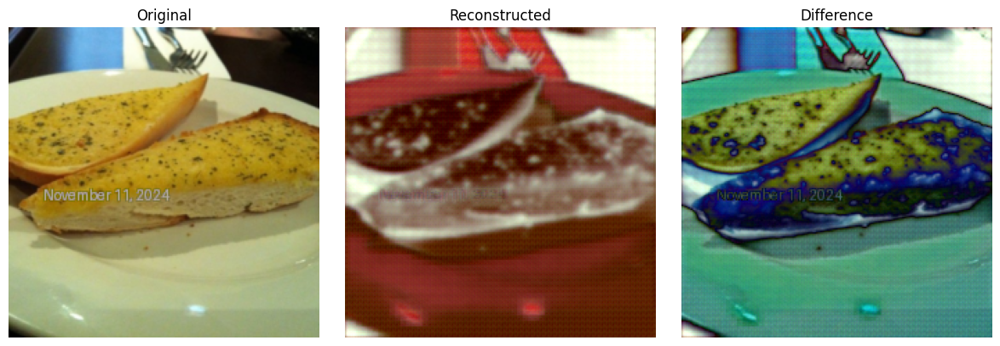

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.18569794..1.2011192].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [3.3080578e-06..1.1893544].


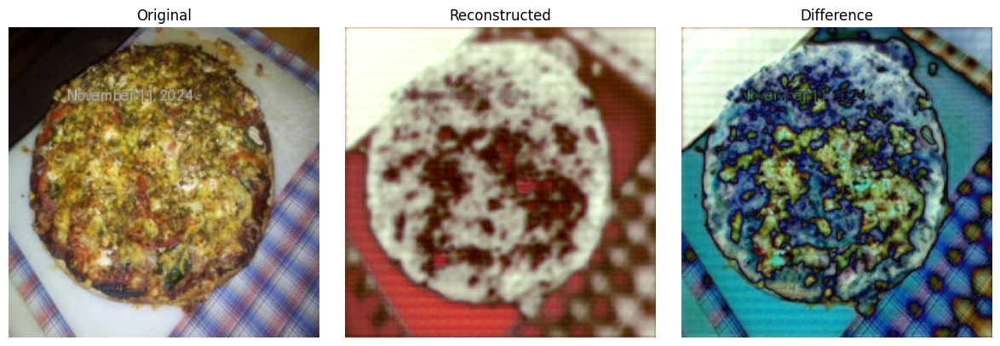

Epoch [7/200], Loss D: 0.6921, Loss G: 0.7012
Epoch [7/200], Loss D: 213.5100, Loss G: 216.5251


In [ ]:
# Train the autoencoder model as a generator
num_epochs = 200
for epoch in range(num_epochs):

    loss_discriminator_e = 0
    loss_generator_e = 0
    a = 0
    for data in train_loader:
        a += 1
        encoder_model.train()
        discriminator_model.train()

        stamped_images, base_images, _ = data
        stamped_images = stamped_images.to(device)
        base_images = base_images.to(device)
        
        # Train the discriminator
        optimizer_discriminator.zero_grad()

        # Labels for real and fake images
        real_labels = torch.full((base_images.size(0), 1), 1.0).to(device)  # Label smoothing for stability
        fake_labels = torch.zeros(stamped_images.size(0), 1).to(device)

        # Generate fake images with the generator
        fake_images = encoder_model(stamped_images)

        # Forward pass through the discriminator
        outputs_real = discriminator_model(base_images)
        loss_real = adversarial_loss(outputs_real, real_labels)

        outputs_fake = discriminator_model(fake_images.detach())
        loss_fake = adversarial_loss(outputs_fake, fake_labels)

        # Total discriminator loss
        loss_discriminator = (loss_real + loss_fake) / 2

        # Backward and optimize discriminator
        loss_discriminator.backward()
        optimizer_discriminator.step()
        loss_discriminator_e += loss_discriminator.item()

        # Train the generator
        optimizer_generator.zero_grad()
        
        fake_images = encoder_model(stamped_images)
        outputs = discriminator_model(fake_images)
        
        # Generator wants the discriminator to think the generated images are real
        loss_generator = adversarial_loss(outputs, real_labels)
        
        # Backward and optimize generator
        loss_generator.backward()
        optimizer_generator.step()
        loss_generator_e += loss_generator.item()

        # Display images and print losses
        if a % 200 == 0:
            data_iter = iter(test_loader)
            stamped_images, base_images, _ = next(data_iter)
            stamped_images = stamped_images.to(device)
            base_images = base_images.to(device)
            
            with torch.no_grad():
                outputs = encoder_model(stamped_images)
            
            stamped_images = stamped_images.cpu()
            outputs = outputs.cpu()
            for i in range(4):
                display_images(stamped_images[i], outputs[i])
            print(f"Epoch [{epoch+1}/{num_epochs}], Loss D: {loss_fake.item():.4f}, Loss G: {loss_generator.item():.4f}")

    print(f"Epoch [{epoch+1}/{num_epochs}], Loss D: {loss_discriminator_e:.4f}, Loss G: {loss_generator_e:.4f}")


In [ ]:
# Load a batch of images and display the original and reconstructed images
data_iter = iter(test_loader)
stamped_images, base_images, _ = next(data_iter)
stamped_images = stamped_images.to(device)
base_images = base_images.to(device)
with torch.no_grad():
    outputs = encoder_model(stamped_images)
  

stamped_images = stamped_images.cpu()
outputs = outputs.cpu()
for i in range(20):
    display_images(stamped_images[i], outputs[i])



## 5.1 Model Selection
<!--
- Choose the model(s) to be trained (e.g., linear regression, decision trees, neural networks).
-->

## 5.2 Model Training
<!--
- Train the selected model(s) using the training data.
-->

## 5.3 Model Evaluation
<!--
- Evaluate model performance on validation data.
- Use appropriate metrics (e.g., accuracy, precision, recall, RMSE).
-->

## 5.4 Hyperparameter Tuning
<!--
- Fine-tune the model using techniques like Grid Search or Random Search.
- Evaluate the impact of different hyperparameters.
-->

## 5.5 Model Testing
<!--
- Evaluate the final model on the test dataset.
- Ensure that the model generalizes well to unseen data.
-->

## 5.6 Model Interpretation (Optional)
<!--
- Interpret the model results (e.g., feature importance, SHAP values).
- Discuss the strengths and limitations of the model.
-->

---

# 6. Predictions


## 6.1 Make Predictions
<!--
- Use the trained model to make predictions on new/unseen data.
-->

## 6.2 Save Model and Results
<!--
- Save the trained model to disk for future use.
- Export prediction results for further analysis.
-->

---

# 7. Documentation and Reporting

## 7.1 Summary of Findings
<!--
- Summarize the results and findings of the analysis.
-->

## 7.2 Next Steps
<!--
- Suggest further improvements, alternative models, or future work.
-->

## 7.3 References
<!--
- Cite any resources, papers, or documentation used.
-->